In [15]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib as matplotlib
from matplotlib import animation, rc
rc('animation', html='jshtml')
from matplotlib import cm

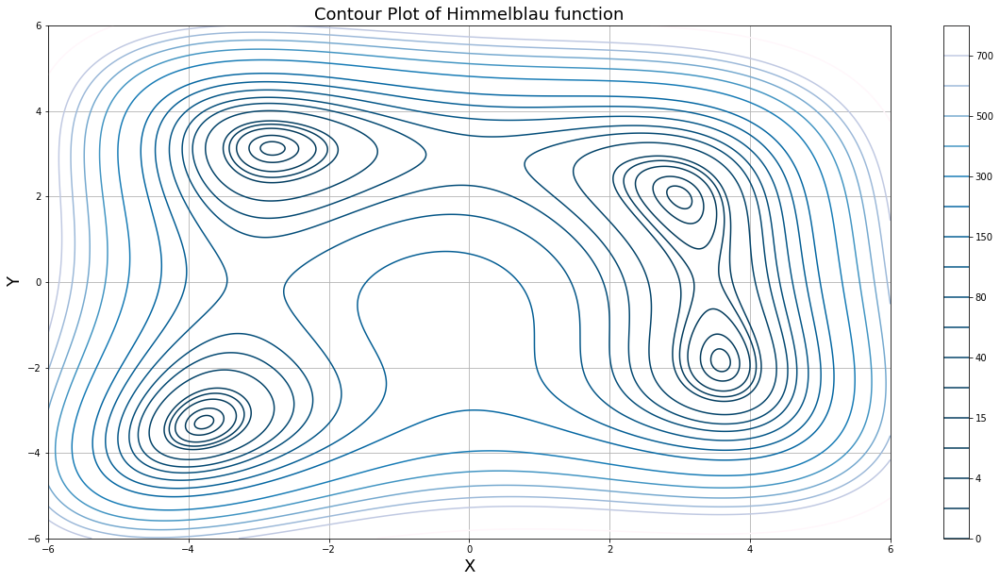

In [2]:
### Defining Himmelblau function ###
def f(x,y):
    return np.power((np.power(x,2)+y-11),2)+np.power((x+np.power(y,2)-7),2)

                    ###############################################################################
                    #################### Creating Contour plot of function ########################
                    ###############################################################################
            
## Defining x- & y-limits for plot ##
xlims, ylims = [-6.0,6.0], [-6.0,6.0]

## Determining levels in function: i.e. Z = 0, 1, 4, 10.... ##
levels = [0,1,4,10,15,20,40,60,80,110,150,200,300,400,500,600,700,1000]

## Setting values for plot ##
xlist = np.linspace(xlims[0],xlims[1],1000)
ylist = np.linspace(ylims[0],ylims[1],1000)
X, Y = np.meshgrid(xlist,ylist)
Z = f(X,Y)

## Defining plot ##
fig, ax = plt.subplots(1,1,figsize = (20,10))
ax.set_title('Contour Plot of Himmelblau function',size=18)
contour_plot = ax.contour(X,Y,Z, levels, antialiased=True,cmap=cm.PuBu_r)
fig.colorbar(contour_plot)
ax.set_xlim(xlims[0],xlims[1]), ax.set_ylim(ylims[0],ylims[1])
ax.set_xlabel("X",size=18), ax.set_ylabel("Y",size=18)
ax.grid()
plt.show()


In [3]:
## Gradient in first derivative by means of finite differences ##
def gradient(func,x,y):
    h = 1.0e-7
    grad = np.array([(func(x+h,y)-func(x,y))/h,(func(x,y+h)-func(x,y))/h])
    return grad

## Defining a function for calculating the euclidean norm af a n-dimensional vector ##
def norm(vector):
    return np.sqrt(np.power(vector[0],2)+np.power(vector[1],2))

## Defining a function for calculating the inner product of a n-dimensional vector ##
def inner_product(vector):
    return np.power(vector[0],2)+np.power(vector[1],2)

 Der tages skridt ved:
 \begin{equation}
 \vec{x}_{n+1}=\vec{x}_n+s_n\vec{P_n}
 \end{equation}
 - Vælger første skridt til at være i negativ retning af gradienten i startpunktet (descent):
 \begin{equation}
 \vec{P_n}=-\nabla f(\vec{x}_n)
 \end{equation}
 - Vælger skridtstørrelsen $s_n$ m. udgangspunkt i Wolfe betingelse i) https://en.wikipedia.org/wiki/Wolfe_conditions, hvor der backrtracking line search på skridstørrelsen: $s_n = s_n\frac{1}{2}$ indtil nedenstående ulighed opfyldes:
  \begin{equation}
 f(\vec{x}_n+s_n\vec{p}_n) \leq f(\vec{x}_n)+\alpha s_n||\nabla f(\vec{x}_n)||^2
 \end{equation}
(her sættes $\alpha = 10^{-4}$).
 - Itererer ovenstående process indtil længden af gradienten er tilstrækkeligt tæt på 0, dvs. indtil
 \begin{equation}
 ||\nabla f(\vec{x}_n)||^2 < tol
 \end{equation}
 hvor det løbende tjekkes at funktionsværdierne rent faktisk mindskes
  \begin{equation}
 f(\vec{x}_{n+1})<f(\vec{x}_{n})
 \end{equation}
 
 


In [4]:
def gradient_descent(func, tol, init_guess):
    tolerance = tol
    x_init, y_init = init_guess[0],init_guess[1]
    x0 = np.array([x_init, y_init])
    steps = [[x_init],[y_init]]
    counter = 0
    while norm(gradient(func,x0[0],x0[1])) > tolerance:
        step_dir = -1.0*gradient(func,x0[0],x0[1])
        ## Finding stepsize by means of backtracking: stepsize -> stepsize/2 ##
        h = 1.0
        alpha = 0.0001
        while func(x0[0]+step_dir[0]*h,x0[1]+step_dir[1]*h) > func(x0[0],x0[1])+alpha*inner_product(step_dir):
            h*=0.5
        
        ## Performing step ##
        steps[0].append(x0[0]+h*step_dir[0]), steps[1].append(x0[1]+h*step_dir[1])
        counter += 1
       
        ## Checking the function value decreases ##
        if func(x0[0]+h*step_dir[0],x0[1]+h*step_dir[1]) > func(x0[0],x0[1]):
            break
        
        x0[0]+=h*step_dir[0]
        x0[1]+=h*step_dir[1]
        
    return steps, counter
    
           

nr. of steps: 21
minimum is (2.999999984706518, 1.9999999773388173)


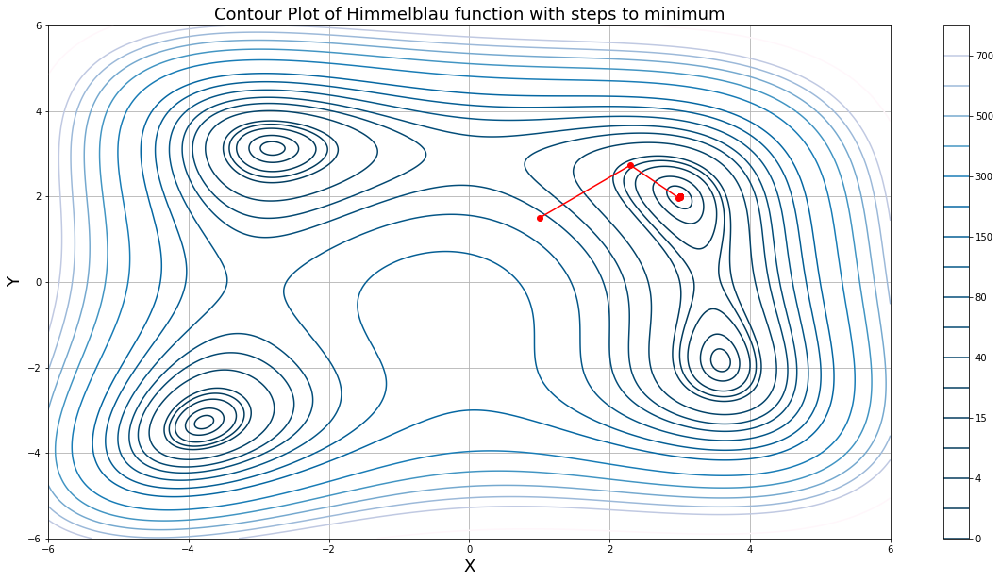

In [5]:
###########################################################################################################################
############### Laver gradient descent på den valgte function, og plotter skridtende oven i et contour plot ###############
###########################################################################################################################

### Husk at give initial guess som floats så der undgåes afrundingsfejl 
x_init, y_init = 1.0, 1.5
tolerance = 1.0e-6
steps, nr_steps = gradient_descent(f,tolerance,[x_init,y_init])

## Defining x- & y-limits for plot ##
xlims, ylims = [-6.0,6.0], [-6.0,6.0]

## Determining levels in function: i.e. Z = 0, 1, 4, 10.... ##
levels = [0,1,4,10,15,20,40,60,80,110,150,200,300,400,500,600,700,1000]

## Setting values for plot ##
xlist = np.linspace(xlims[0],xlims[1],1000)
ylist = np.linspace(ylims[0],ylims[1],1000)
X, Y = np.meshgrid(xlist,ylist)
Z = f(X,Y)

## Defining plot ##
print(f'nr. of steps: {nr_steps}')
print(f'minimum is {steps[0][-1],steps[1][-1]}')
fig, ax = plt.subplots(1,1,figsize = (20,10))
ax.set_title('Contour Plot of Himmelblau function with steps to minimum',size=18)
contour_plot = ax.contour(X,Y,Z, levels, antialiased=True,cmap=cm.PuBu_r)
fig.colorbar(contour_plot)
ax.plot(steps[0],steps[1],color = "red")
ax.plot(steps[0],steps[1],"ro")
ax.set_xlim(xlims[0],xlims[1]), ax.set_ylim(ylims[0],ylims[1])
ax.set_xlabel("X",size=18), ax.set_ylabel("Y",size=18)
ax.grid()
plt.show()


Quasi-Newton - bygger på skridtet:
\begin{equation}
\vec{x}_{n+1}=\vec{x}_n+\vec{s}_n,\quad \vec{s}=-\lambda\mathbf{H}(\vec{x})^{-1}\nabla f(\vec{x})
\end{equation}

hvor $\mathbf{H}(\vec{x})^{-1}$ er den inverse hesse matrix, som indledningsvist sættes til identitetsmatricen:
\begin{equation}
\mathbf{H}(\vec{x}_0)^{-1}=\mathbf{I}
\end{equation}

Hesse matricen opdateres for hver skridt:
\begin{equation}
\mathbf{H}(\vec{x}_{n+1})^{-1}=\mathbf{H}(\vec{x}_{n})^{-1}+\delta\mathbf{H}(\vec{x}_{n})^{-1}
\end{equation}

Her via. SR1 (symmetric rank 1) opdateringen:
\begin{equation}
\delta\mathbf{H}(\vec{x})^{-1}=\frac{\vec{u}\,\vec{u}^T}{\vec{u}^T\vec{y}}
\end{equation}
hvor $\vec{y}=\nabla f(\vec{x}+\vec{s})-\nabla f(\vec{x})$ og $\vec{u}=\vec{s}-\mathbf{H}(\vec{x})^{-1}\vec{y}$.

Skridtet $\vec{s}$ er bestemt for hver iteration vha. backtracking line search mht. Armijo betingelsen, således at $\lambda \rightarrow \lambda/2$, indtil:
\begin{equation}
f(\vec{x}+\vec{s}) \leq f(\vec{x})+\alpha\vec{s}^T\nabla f(\vec{x})
\end{equation}

og $\alpha=10^{-4}$.

Efterfølgende $\lambda \rightarrow 2\lambda$ indtil curvature betingelsen er opfyldt:
\begin{equation}
\nabla f(\vec{x}_n+\vec{s})^T\frac{\vec{s}}{\lambda} \geq \beta \nabla f(\vec{x}_n)^T\frac{\vec{s}}{\lambda}
\end{equation}
og $\beta = 0.9$.

Ovenstående itereres indtil gradienten er tilstræklig tæt på 0, og så længde at skridtstørrelsen er tilstrækkelse dvs. så længe:
\begin{equation}
||\nabla f(\vec{x})|| \geq tol\quad \textrm{&&}\quad ||\vec{s}_n|| \geq tol
\end{equation}

I nogle Quasi-newton metoder er det en fordel indledningsvist at have en god approksimation for hessematricen i stedet for at bruge identitetsmatricen. Søjlerne i hesse matricen kan approximeres vha. gradienten:
\begin{equation}
\mathbf{H}(\vec{x}_0)\vec{e}_i=\frac{\nabla f(\vec{x}_0+h\vec{e}_i)-f(\vec{x}_0)}{h}\vec{e}_i
\end{equation}
hvor $h << 1$ er en passende valgt skridtstørrelse.

In [6]:
### re-Defining Himmelblau function ###
def f(x):
    return np.power((np.power(x[0],2)+x[1]-11),2)+np.power((x[0]+np.power(x[1],2)-7),2)

## re-defining Gradient in first derivative by means of finite differences ##
def gradient(func,x):
    h = 0.001
    ## creating unit vectors ##
    unit_vecs = []
    for i in range(len(x)):
        temp = []
        for j in range(len(x)):
            temp.append(0.0)
        temp[i] = 1.0
        unit_vecs.append(np.array(temp))
        
    ## calculating gradient ##
    gradient = np.zeros(len(x))
    for i in range(len(x)):
        gradient += ((func(x+h*unit_vecs[i])-func(x))/h)*unit_vecs[i] 
    return gradient

## A function for approximating the hessian matrix ##
def hessian(func,grad_func,x):
    h = 0.001
    unit1, unit2 = np.array([1.0,0.0]), np.array([0.0,1.0])
    col1 = (grad_func(func,x+h*unit1)-grad_func(func,x))/h
    col2 = (grad_func(func,x+h*unit2)-grad_func(func,x))/h
    hessian = np.matrix([[col1[0],col2[0]],[col1[1],col2[1]]])
    return hessian

## A function for creating an n-dimensional identity matrix ##
def identity_matrix(dimensions):
    arrays = []
    for i in range(dimensions):
        temp = []
        for j in range(dimensions):
            temp.append(0.0)
        temp[i] = 1.0
        arrays.append(temp)
    return np.matrix(arrays)

## Defining a function for performing SR1 uppdate in quasi newton ##
def SR1_update(H_inverse,x,s,eps,grad_func,func):
    inv_H = H_inverse
    y = np.array(grad_func(func,x+s)-grad_func(func,x))
    u = np.array((s-(inv_H@y)))[0]
    if abs(np.inner(y,u)) > eps:
        delta_H_inv = np.matrix(np.outer(u,u))/(np.inner(y,u))
        inv_H += delta_H_inv
    return inv_H


## Defining a function for performing the quasi-newton algorythm ##
def quasi_newton(func, tol, eps, init_guess):
    
    ## Initial definitions ##
    step_tol = 10.0**(-10)
    x0 = np.array([init_guess[i] for i in range(len(init_guess))])
    steps = [[init_guess[0]],[init_guess[1]]]
    counter = 0
    inverse_hessian = identity_matrix(len(x0))
    while norm(gradient(func,x0)) >= tol and counter < 30:   
        
                                ###########################
                                #### Finding stepsize #####
                                ###########################
        lambd = 1.0
        lambd_min = 10.0**(-6)
        alpha = 0.0001
        grad = gradient(func,x0)
        s = np.array(-lambd*(inverse_hessian@grad))[0]  
        
        ###### Armijo condition ######
        while func(x0+s) >= func(x0)+alpha*lambd*(np.inner(x0,grad)):
            if lambd <= lambd_min:
                inverse_hessian = identity_matrix(len(x0))
                break
            lambd *= 0.5
            s = np.array(-lambd*(inverse_hessian@grad))[0]

        beta = 0.90
        s = np.array(-lambd*(inverse_hessian@grad))[0]
        grad_s = gradient(func,x0+s)
        left = (1.0/lambd)*(np.inner(grad_s,s))
        
        ###### Curvature condition ######
        while left < beta*(1.0/lambd)*(np.inner(s,grad)):
            lambd*=2.0
            s = np.array(-lambd*(inverse_hessian@grad))[0]
            grad_s = gradient(func,x0+s)
            left = (1.0/lambd)*(np.inner(grad_s,s))
        
        ## Calculating update for inverse hessian approximation ##
        inverse_hessian = SR1_update(inverse_hessian,x0,s,eps,gradient,func)
        #inverse_hessian = Symmetric_Broyden_update(inverse_hessian,x0,s,eps,lambd,gradient,func)
    
        ## Checking stepsize and performing step ##
        s = -lambd*np.array((inverse_hessian@gradient(func,x0)))[0]
        if norm(s) < step_tol:
            ## Step size to small - stop iteration ##
            print("breaking due to small stepsize")
            break
        x0 += s
        
        ## Saving step ##
        steps[0].append(x0[0]), steps[1].append(x0[1])
        
        ## Updating counter ##
        counter += 1
    return steps, counter

nr. of steps: 6
minimum is (-2.8056075416130732, 3.1308248016394042)


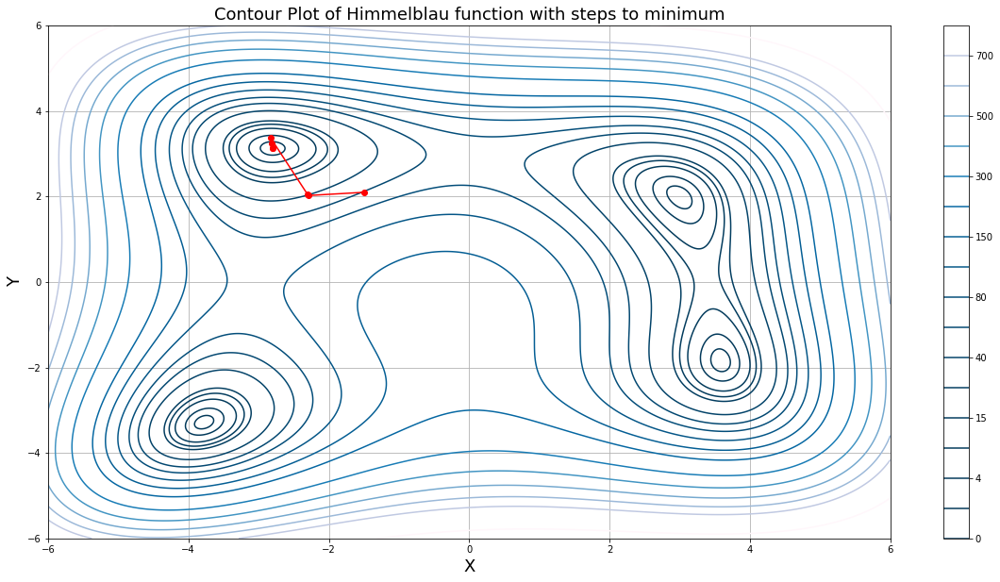

In [7]:
### Husk at give initial guess som floats så der undgåes afrundingsfejl 
x_init, y_init = -1.5, 2.1
tolerance = 1.0e-3
epsilon = 1.0e-5
steps, nr_steps = quasi_newton(f,tolerance,epsilon,[x_init,y_init])

## Defining x- & y-limits for plot ##
xlims, ylims = [-6.0,6.0], [-6.0,6.0]

## Determining levels in function: i.e. Z = 0, 1, 4, 10.... ##
levels = [0,1,4,10,15,20,40,60,80,110,150,200,300,400,500,600,700,1000]

## Setting values for plot ##
xlist = np.linspace(xlims[0],xlims[1],1000)
ylist = np.linspace(ylims[0],ylims[1],1000)
X, Y = np.meshgrid(xlist,ylist)
Z = np.power((np.power(X,2)+Y-11),2)+np.power((X+np.power(Y,2)-7),2)

## Defining plot ##
print(f'nr. of steps: {nr_steps}')
print(f'minimum is {steps[0][-1],steps[1][-1]}')
fig, ax = plt.subplots(1,1,figsize = (20,10))

ax.set_title('Contour Plot of Himmelblau function with steps to minimum',size=18)
contour_plot = ax.contour(X,Y,Z, levels, antialiased=True,cmap=cm.PuBu_r)
fig.colorbar(contour_plot)
ax.plot(steps[0],steps[1],color = "red")
ax.plot(steps[0],steps[1],"ro")
ax.set_xlim(xlims[0],xlims[1]), ax.set_ylim(ylims[0],ylims[1])
ax.set_xlabel("X",size=18), ax.set_ylabel("Y",size=18)
ax.grid()
plt.show()

In [8]:
### re-Defining Himmelblau function ###
def f(x):
    return np.power((np.power(x[0],2)+x[1]-11),2)+np.power((x[0]+np.power(x[1],2)-7),2)

## Defining a function for doing a reflection of highest point ##
def reflection(func,simplex):
    ## Creating list of function values of alle points in simplex ##
    func_vals = np.array([func(simplex[i]) for i in range(len(simplex))])
    ## Finding index of point with highest function val ##
    max_index = np.argmax(func_vals)
    ## Calculating centroid ##
    centroid = np.zeros(len(simplex[0]))
    for i in range(len(simplex)):
        if i != max_index:
            #print("centroid:",centroid, "simplex[i]",simplex[i])
            centroid += simplex[i]
    centroid *= 1.0/(len(simplex)-1.0)
    ## Reflection of highest point ##
    simplex[max_index] = centroid+(centroid-simplex[max_index])
    return simplex[max_index], simplex

## Defining a function for doing an expansion of highest point ##   
def expansion(func,simplex):
    ## Creating list of function values of alle points in simplex ##
    func_vals = np.array([func(simplex[i]) for i in range(len(simplex))])
    ## Finding index of point with highest function val ##
    max_index = np.argmax(func_vals)
    ## Calculating centroid ##
    centroid = np.zeros(len(simplex[0]))
    for i in range(len(simplex)):
        if i != max_index:
            centroid += simplex[i]
    centroid *= 1.0/(len(simplex)-1.0)    
    ## Expansion of highest point ##
    simplex[max_index] = centroid+2.0*(centroid-simplex[max_index])
    return simplex[max_index], simplex 

## Defining a function for doing a contraction of highest point ##   
def contraction(func,simplex):
    ## Creating list of function values of alle points in simplex ##
    func_vals = np.array([func(simplex[i]) for i in range(len(simplex))])
    ## Finding index of point with highest function val ##
    max_index = np.argmax(func_vals)
    ## Calculating centroid ##
    centroid = np.zeros(len(simplex[0]))
    for i in range(len(simplex)):
        if i != max_index:
            centroid += simplex[i]
    centroid *= 1.0/(len(simplex)-1.0)    
    ## Expansion of highest point ##
    simplex[max_index] = centroid+0.5*(simplex[max_index]-centroid)
    return simplex[max_index], simplex 

## Defining a function for doing a reduction of alle points except lowest ##   
def reduction(func,simplex):
    ## Creating list of function values of alle points in simplex ##
    func_vals = np.array([func(simplex[i]) for i in range(len(simplex))])
    ## Finding index of point with lowest function val ##
    min_index = np.argmin(func_vals)
    ## reduction of all points except lowest ##
    for i in range(len(simplex)):
        if i != min_index:
            simplex[i] = 0.5*(simplex[i]+simplex[min_index])
    return simplex 

## Defining a function for calculating the size of the simplex ##
def simplex_size(simplex):
    # Calculting distances between points in simplex #
    distances = []
    for i in range(len(simplex)):
        for j in range(len(simplex)):
            if i < j:
                distances.append(np.linalg.norm(simplex[i]-simplex[j]))
    return np.sum(distances)

In [9]:
def downhill_simplex(func,simplex, tol):
    
    counter = 0
    steps = [[list(simplex[i]) for i in range(len(simplex))]]
    current_simplex = simplex
    while simplex_size(current_simplex) >= tol:
        ## Creating list of function values of alle points in simplex ##
        func_vals = np.array([func(current_simplex[i]) for i in range(len(current_simplex))])
        ## Trying reflection ##
        reflected_point, reflected_simplex = reflection(func,current_simplex)
        if func(reflected_point) < np.min(func_vals):
            ## Trying expansion ##
            expanded_point, expanded_simplex = expansion(func,current_simplex)
            if func(expanded_point) < func(reflected_point):
                ## Accepting expansion ##
                current_simplex=expanded_simplex
            else:
                ## Accepting reflection ##
                current_simplex=reflected_simplex
        else:
            if func(reflected_point) < np.max(func_vals):
                ## Accepting reflection ##
                current_simplex=reflected_simplex
            else:
                ## Trying contraction ##
                contracted_point, contracted_simplex = contraction(func,current_simplex)
                if func(contracted_point) < np.max(func_vals):
                    ## Accepting contraction ##
                    current_simplex=contracted_simplex
                else:
                    ## computing reduction of simplex ##
                    current_simplex=reduction(func,current_simplex)
                    
        ## Saving current step and incrementing counter ##
        temp = [list(current_simplex[i]) for i in range(len(current_simplex))]
        steps.append(temp)
        counter += 1
    return counter, steps

nr of steps =  50
final simplex = [[-2.8029912633319327, 3.1311944781118655], [-2.80446509104695, 3.1301530435266613], [-2.807116533494991, 3.131191313157615]]


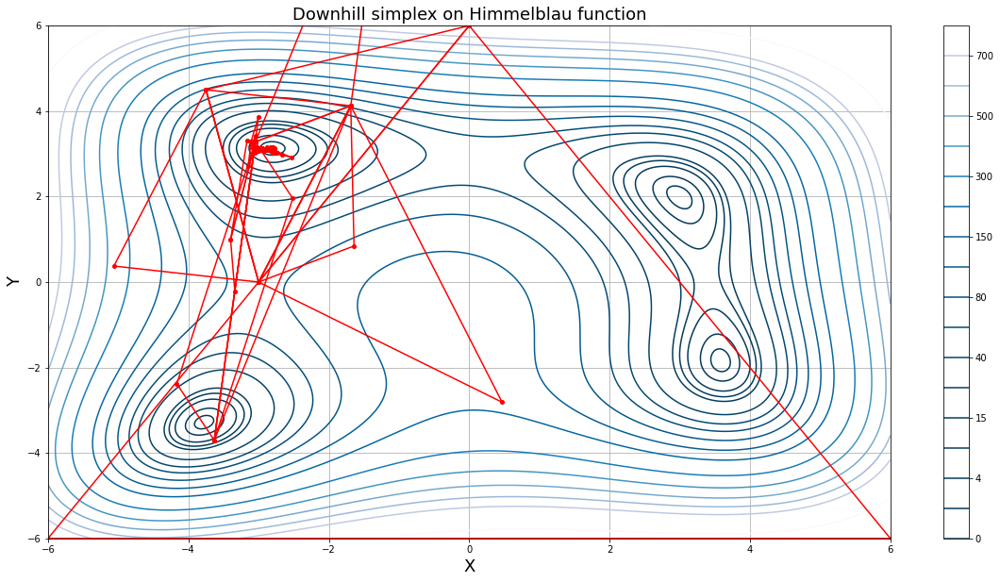

In [68]:
                    ###############################################################################
                    #################### Creating Contour plot of function ########################
                    ###############################################################################
            
## Defining x- & y-limits for plot ##
xlims, ylims = [-6.0,6.0], [-6.0,6.0]

## Determining levels in function: i.e. Z = 0, 1, 4, 10.... ##
levels = [0,1,4,10,15,20,40,60,80,110,150,200,300,400,500,600,700,1000]

## Setting values for  contourplot ##
xlist = np.linspace(xlims[0],xlims[1],1000)
ylist = np.linspace(ylims[0],ylims[1],1000)
X, Y = np.meshgrid(xlist,ylist)
Z = np.power((np.power(X,2)+Y-11),2)+np.power((X+np.power(Y,2)-7),2)


## Computing simplex algorithm ##
simplex_init = [np.array([-6.0,-6.0]),np.array([0.0,6.0]),np.array([6.0,-6.0])]
nr_steps, simplex_steps = downhill_simplex(f,simplex_init, 0.01)
print("nr of steps = ",nr_steps)
print("final simplex =", simplex_steps[-1])



## Defining plot ##
fig, ax = plt.subplots(1,1,figsize = (20,10))
ax.set_title('Downhill simplex on Himmelblau function',size=18)
contour_plot = ax.contour(X,Y,Z, levels, antialiased=True,cmap=cm.PuBu_r)
fig.colorbar(contour_plot)

simplex_x, simplex_y = [], []
for i in range(len(simplex_steps)):
    temp_x, temp_y  = [], []
    for j in range(len(simplex_steps[i])):
        temp_x.append(simplex_steps[i][j][0])
        temp_y.append(simplex_steps[i][j][1])
    temp_x.append(simplex_steps[i][0][0])
    temp_y.append(simplex_steps[i][0][1])
    simplex_x.append(temp_x), simplex_y.append(temp_y)
ax.set_xlim(xlims[0],xlims[1]), ax.set_ylim(ylims[0],ylims[1])
ax.set_xlabel("X",size=18), ax.set_ylabel("Y",size=18)
ax.grid()
## Plotting simplex steps ##
for i in range(len(simplex_steps)):
    for j in range(len(simplex_steps[i])):
        ax.plot(simplex_steps[i][j][0],simplex_steps[i][j][1],'ro',ms=4)
    ax.plot(simplex_x[i],simplex_y[i],color='red')
    ## Uncomment below to save images ##
    #plt.savefig("Images/figure"+str(i)+".jpg", dpi = 100, pil_kwargs={"quality": 95,"optimize":True}, format = "jpg")
plt.show()

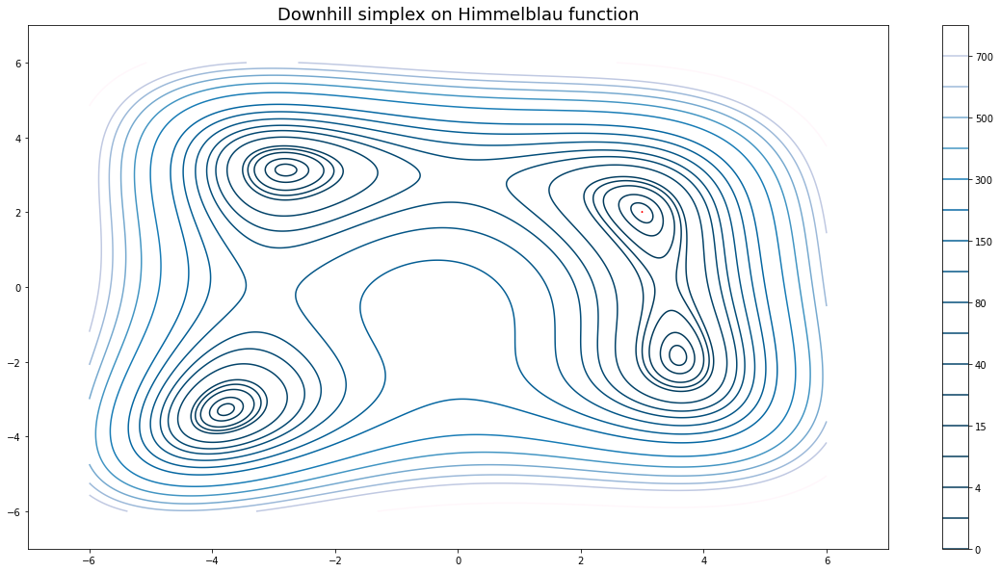

In [38]:

## Defining plot ##
fig, ax = plt.subplots(1,1,figsize = (20,10))
ax.set_title('Downhill simplex on Himmelblau function',size=18)
contour_plot = ax.contour(X,Y,Z, levels, antialiased=True,cmap=cm.PuBu_r)
fig.colorbar(contour_plot)

lines, = ax.plot([],[],color='red')


def update(i):
    lines.set_data(simplex_x[i],simplex_y[i])

    return dots, lines


ax.set_xlim(-7,7)
ax.set_ylim(-7,7)
anim = animation.FuncAnimation(fig,
                               update,
                               frames=len(simplex_x),
                               interval=300,
                               blit=True,
                               repeat_delay=0)
# Set up formatting for the movie files

## uncomment below to save gif ##
writergif = animation.PillowWriter(fps=5) 
anim.save("anim4.gif", writer=writergif)

anim

nr of steps =  94
final simplex = [[0.998533176840283, 0.9971769920084625], [0.9996432112529874, 0.9990432132035494], [0.9981546380149666, 0.996325796993915]]


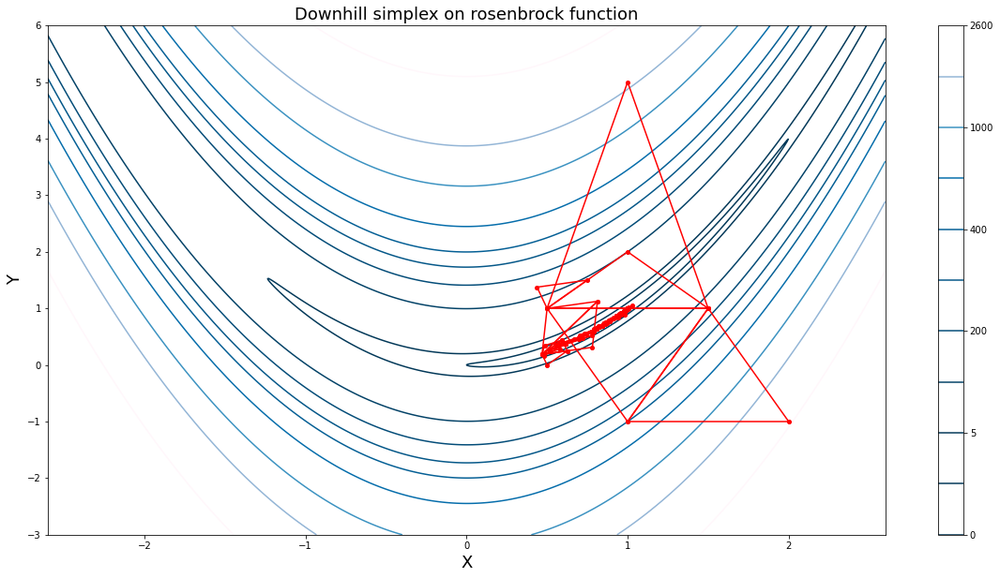

In [85]:
                   ###############################################################################
                    #################### Creating Contour plot of function ########################
                    ###############################################################################
            
## Defining x- & y-limits for plot ##
xlims, ylims = [-2.6,2.6], [-3.0,6.0]

## Determining levels in function: i.e. Z = 0, 1, 4, 10.... ##
levels = [0,1,5,100,200,300,400,600,1000,1500,2600]
## Setting values for  contourplot ##
xlist = np.linspace(xlims[0],xlims[1],1000)
ylist = np.linspace(ylims[0],ylims[1],1000)
X, Y = np.meshgrid(xlist,ylist)
Z = np.power(1.0-X,2)+100.0*np.power((Y-np.power(X,2)),2)

def f2(x):
    return np.power(1.0-x[0],2)+100.0*np.power((x[1]-np.power(x[0],2)),2)

## Computing simplex algorithm ##
tol = 0.01
simplex_init = [np.array([1.0,-1.0]),np.array([1.5,1.0]),np.array([2.0,-1.0])]
nr_steps, simplex_steps = downhill_simplex(f2,simplex_init, tol)
print("nr of steps = ",nr_steps)
print("final simplex =", simplex_steps[-1])

simplex_x, simplex_y = [], []
for i in range(len(simplex_steps)):
    temp_x, temp_y  = [], []
    for j in range(len(simplex_steps[i])):
        temp_x.append(simplex_steps[i][j][0])
        temp_y.append(simplex_steps[i][j][1])
    temp_x.append(simplex_steps[i][0][0])
    temp_y.append(simplex_steps[i][0][1])
    simplex_x.append(temp_x), simplex_y.append(temp_y)


## Defining plot ##
fig, ax = plt.subplots(1,1,figsize = (20,10))
ax.set_title('Downhill simplex on rosenbrock function',size=18)
contour_plot = ax.contour(X,Y,Z, levels, antialiased=True,cmap=cm.PuBu_r)
fig.colorbar(contour_plot)
ax.set_xlim(xlims[0],xlims[1]), ax.set_ylim(ylims[0],ylims[1])
ax.set_xlabel("X",size=18), ax.set_ylabel("Y",size=18)
## Plotting simplex steps ##
for i in range(len(simplex_steps)):
    for j in range(len(simplex_steps[i])):
        ax.plot(simplex_steps[i][j][0],simplex_steps[i][j][1],'ro',ms=4)
    ax.plot(simplex_x[i],simplex_y[i],color='red')
    
plt.show()

Animation size has reached 21227715 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


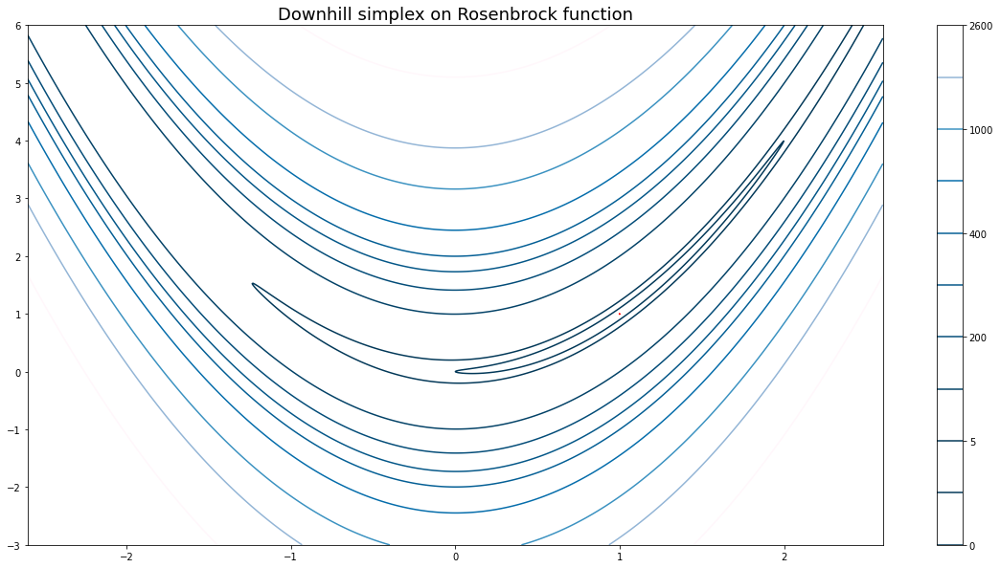

In [87]:

## Defining plot ##
fig, ax = plt.subplots(1,1,figsize = (20,10))
ax.set_title('Downhill simplex on Rosenbrock function',size=18)
contour_plot = ax.contour(X,Y,Z, levels, antialiased=True,cmap=cm.PuBu_r)
fig.colorbar(contour_plot)

dots, = ax.plot([],[],'ro',ms=4)
lines, = ax.plot([],[],color='red')


def update(i):
    lines.set_data(simplex_x[i],simplex_y[i])

    return dots, lines


ax.set_xlim(xlims[0],xlims[1])
ax.set_ylim(ylims[0],ylims[1])

anim = animation.FuncAnimation(fig,
                               update,
                               frames=len(simplex_x),
                               interval=300,
                               blit=True,
                               repeat_delay=0)

# Set up formatting for the movie files

## uncomment below to save gif ##
writergif = animation.PillowWriter(fps=5) 
anim.save("anim6.gif", writer=writergif)

anim

hehee
\begin{equation}
\sum_{i=1}^{\infty}
\end{equation}